# Object Detection Demo
Welcome to the object detection inference walkthrough!  This notebook will walk you step by step through the process of using a pre-trained model to detect objects in an image. Make sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/object_detection/g3doc/installation.md) before you start.

# Imports

In [1]:
import numpy as np
import os
import sys
import tensorflow as tf

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

## Env setup

In [2]:
%matplotlib inline

## Object detection imports
Here are the imports from the object detection module.

In [3]:
from utils import label_map_util

from utils import visualization_utils as vis_util

ImportError: No module named 'utils'

# Model preparation 

In [4]:

CKPT = 'fine_tuned_model_4/frozen_inference_graph.pb'
PATH_TO_LABELS = 'label_map.pbtxt'

NUM_CLASSES = 14

## Load a (frozen) Tensorflow model into memory.

In [5]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [6]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)
print(category_index)

{1: {'id': 1, 'name': 'Green'}, 2: {'id': 2, 'name': 'Red'}, 3: {'id': 3, 'name': 'GreenLeft'}, 4: {'id': 4, 'name': 'GreenRight'}, 5: {'id': 5, 'name': 'RedLeft'}, 6: {'id': 6, 'name': 'RedRight'}, 7: {'id': 7, 'name': 'Yellow'}, 8: {'id': 8, 'name': 'off'}, 9: {'id': 9, 'name': 'RedStraight'}, 10: {'id': 10, 'name': 'GreenStraight'}, 11: {'id': 11, 'name': 'GreenStraightLeft'}, 12: {'id': 12, 'name': 'GreenStraightRight'}, 13: {'id': 13, 'name': 'RedStraightLeft'}, 14: {'id': 14, 'name': 'RedStraightRight'}}


## Helper code

In [7]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

# Detection

In [8]:
from glob import glob

In [11]:

PATH_TO_TEST_IMAGES_DIR = 'test_images'

print(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))
print("Length of test images:", len(TEST_IMAGE_PATHS))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

test_images/*.jpg
Length of test images: 75


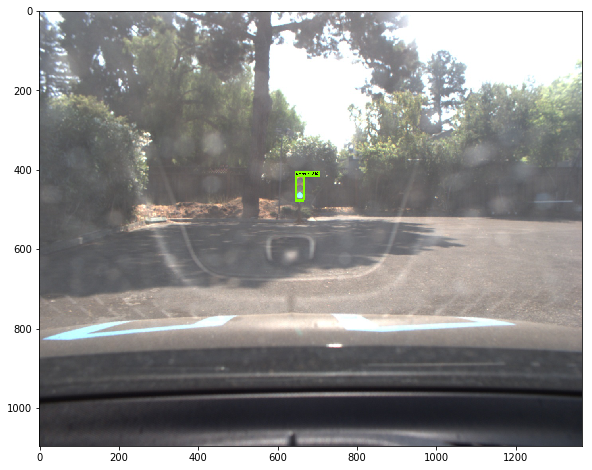

Green 0.999844


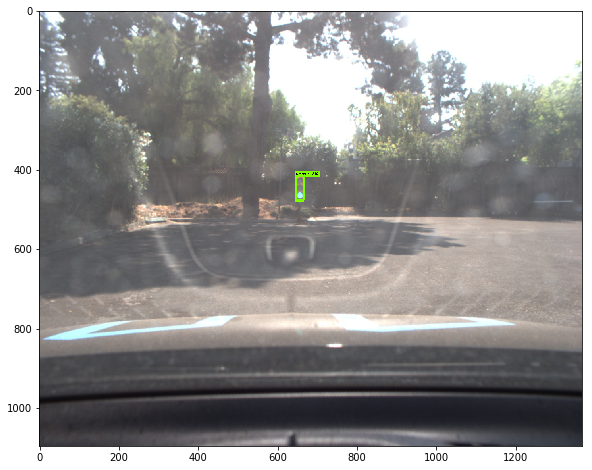

Green 0.999823


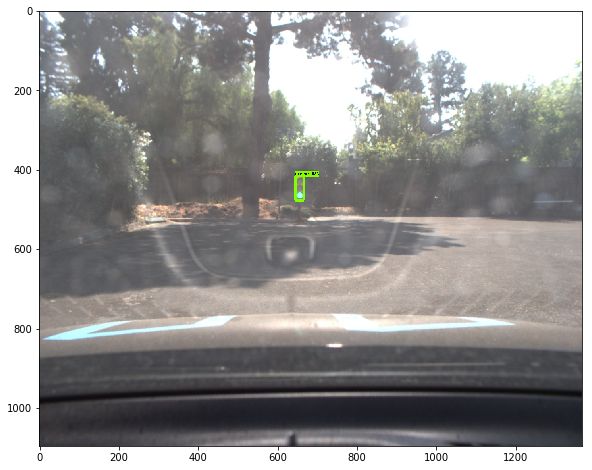

Green 0.999866


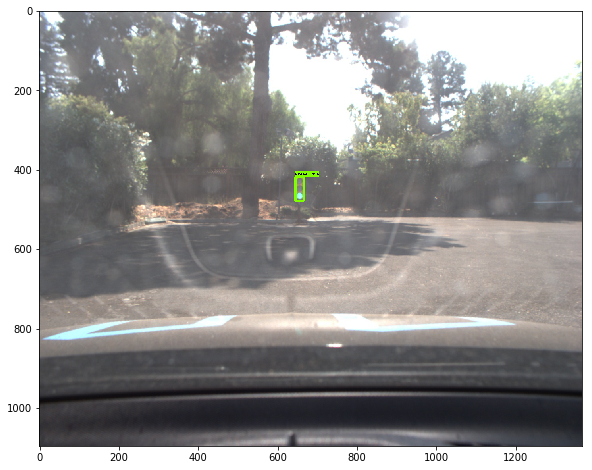

Green 0.999945


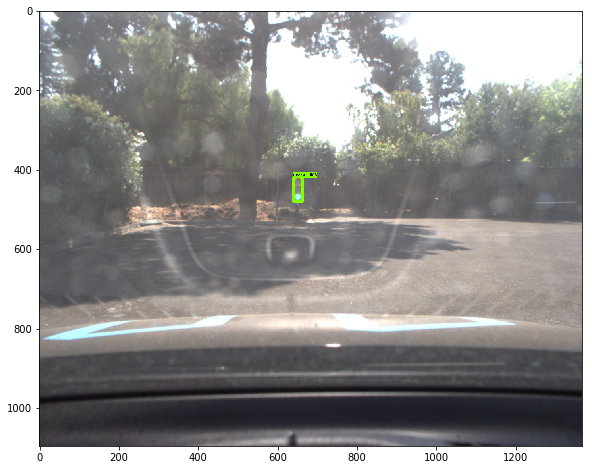

Green 0.999892


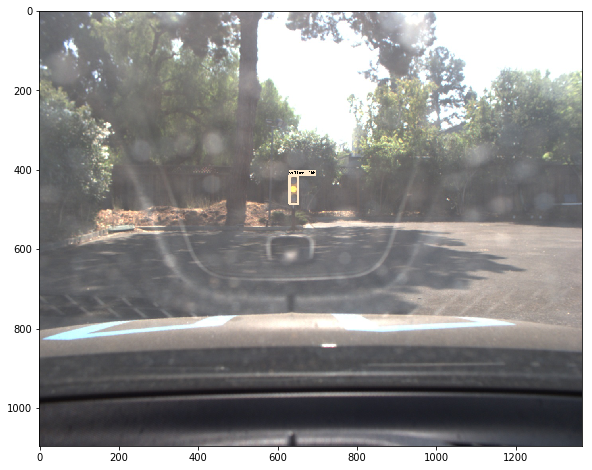

Yellow 0.996907


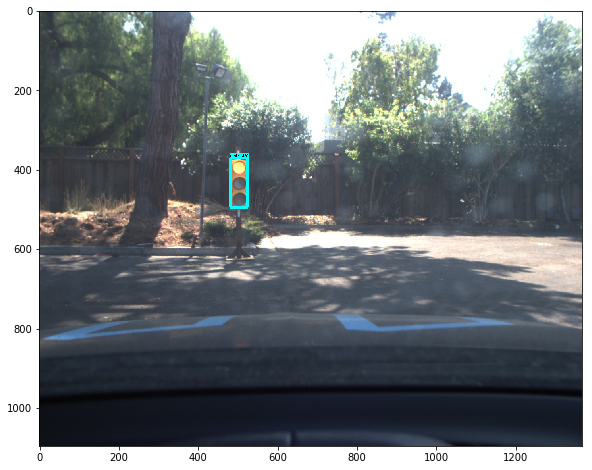

Red 0.999968


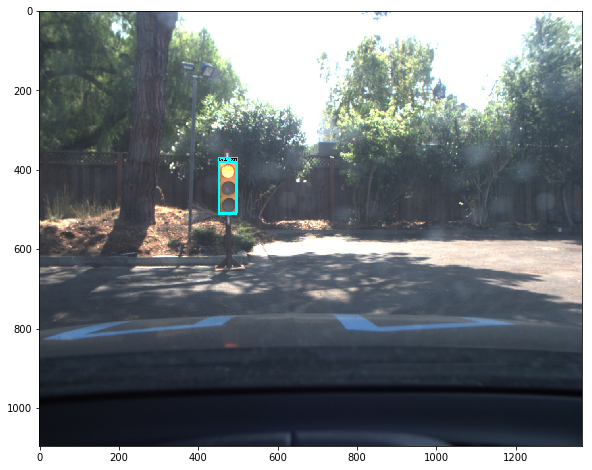

Red 0.99992


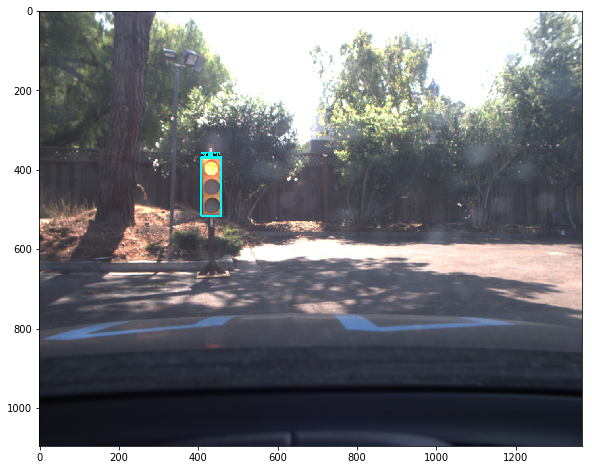

Red 0.99992


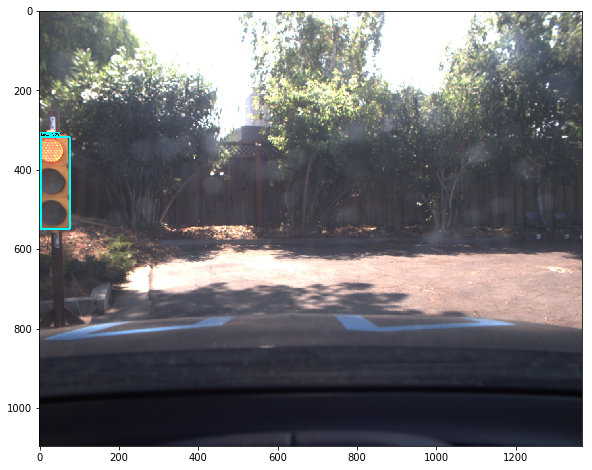

Red 0.991065


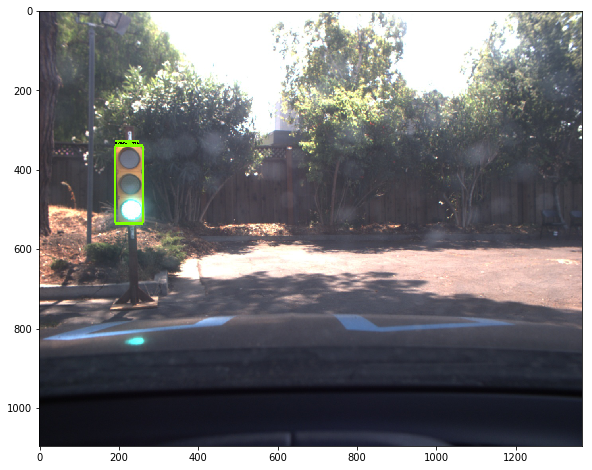

Green 0.999662


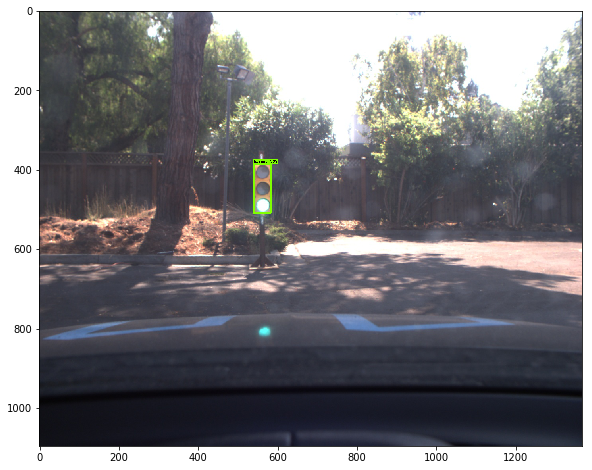

Green 0.999949


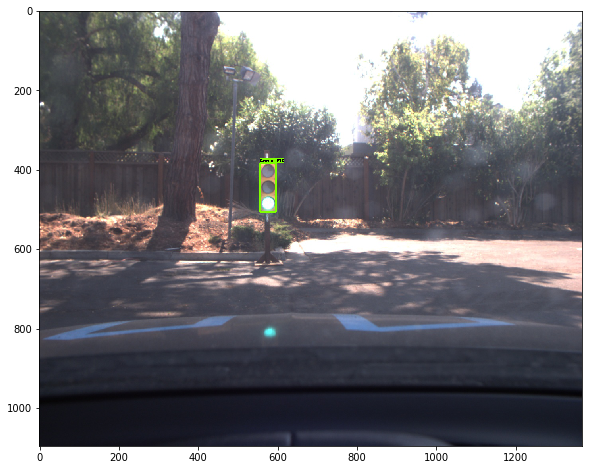

Green 0.999904


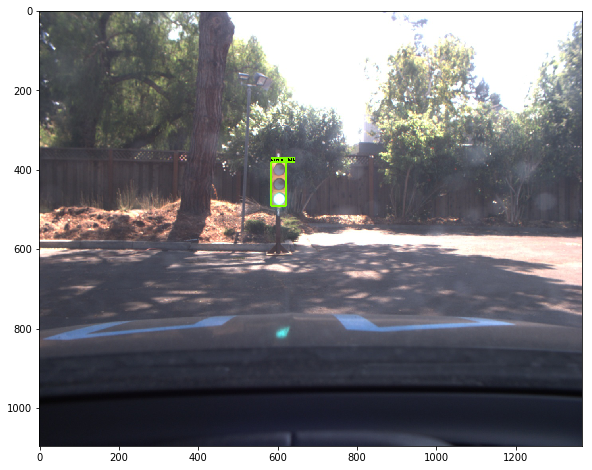

Green 0.999602


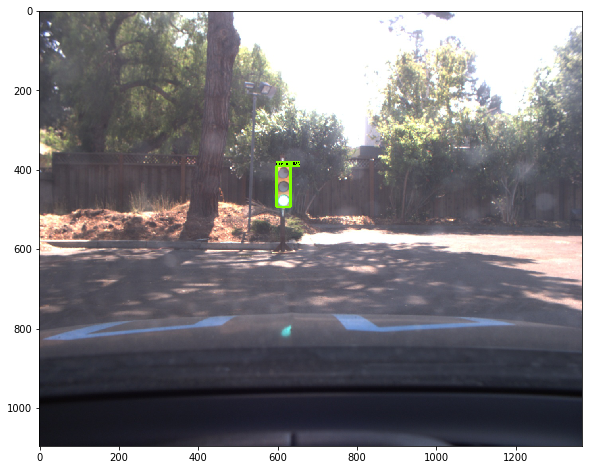

Green 0.999887


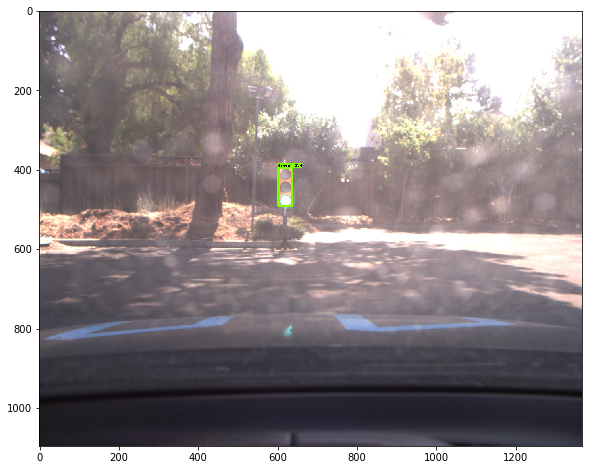

Green 0.999659


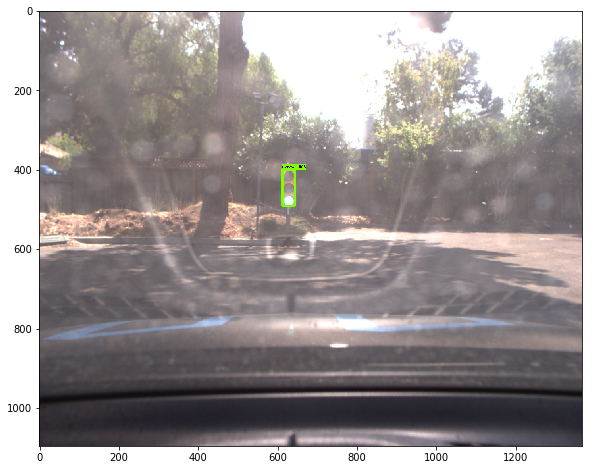

Green 0.999963


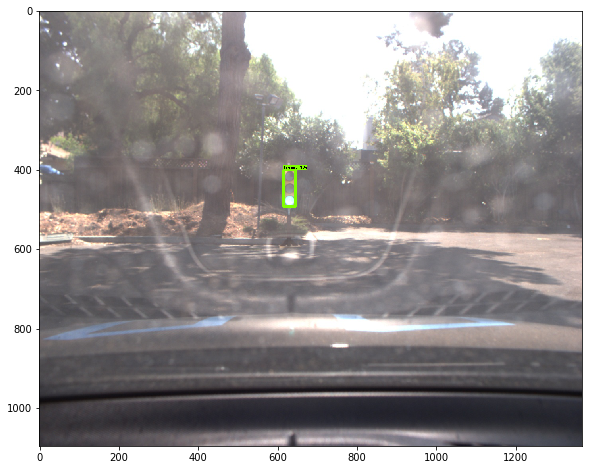

Green 0.999852


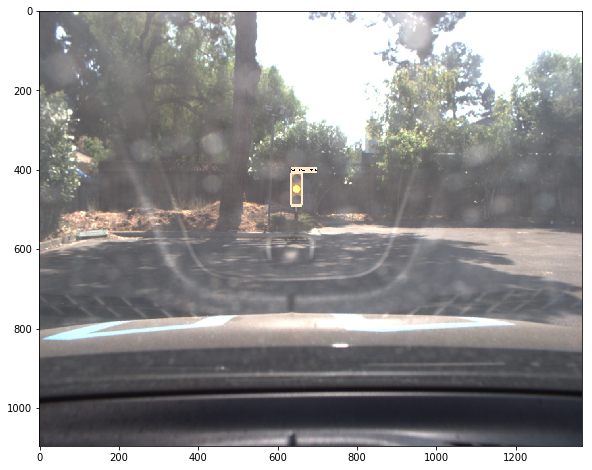

Yellow 0.999405


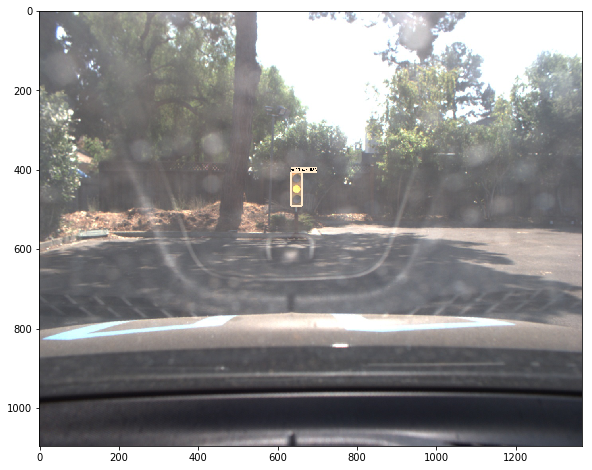

Yellow 0.996617


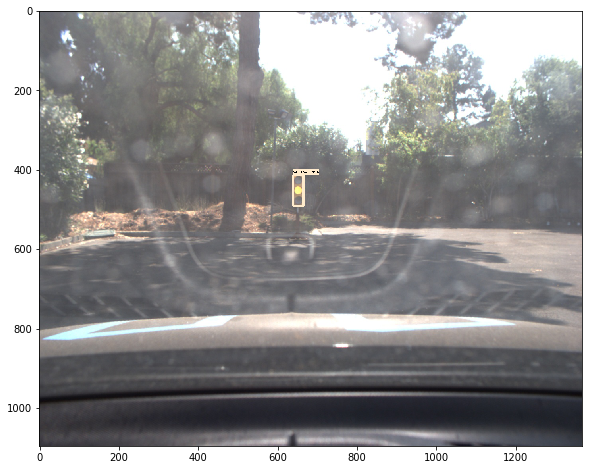

Yellow 0.999763


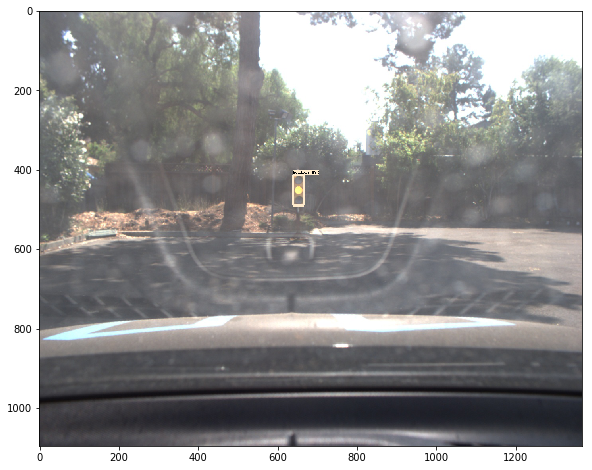

Yellow 0.999816


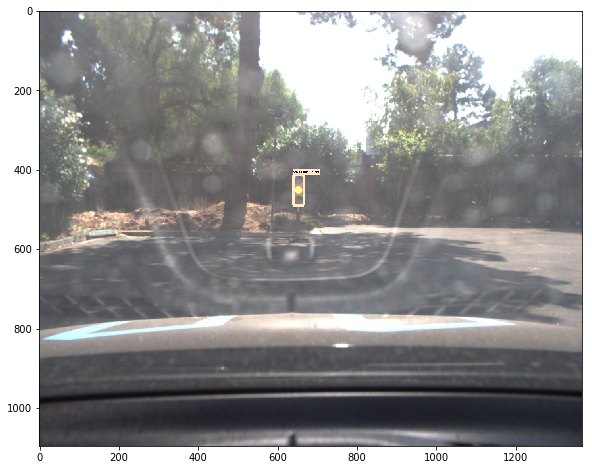

Yellow 0.999828


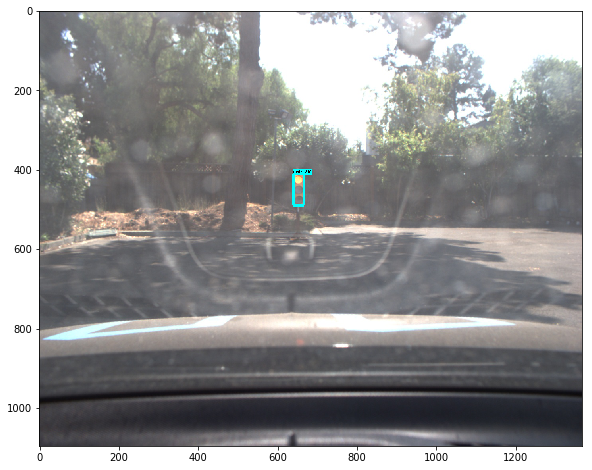

Red 0.999988


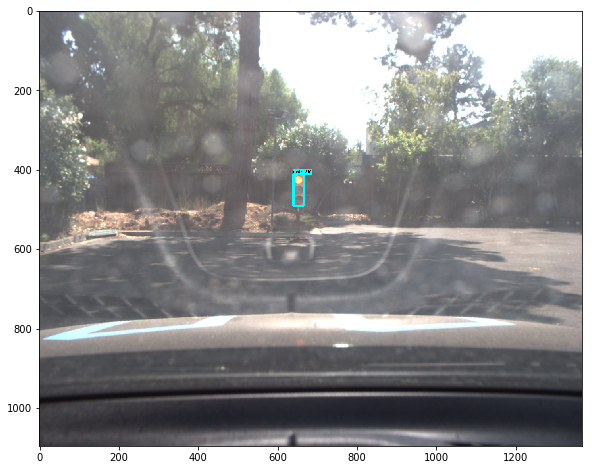

Red 0.999985


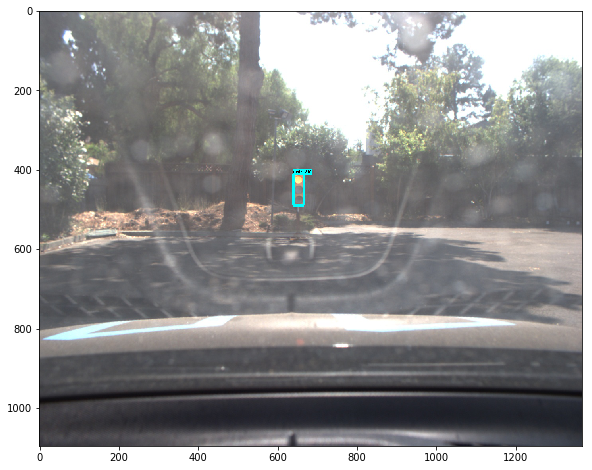

Red 0.999985


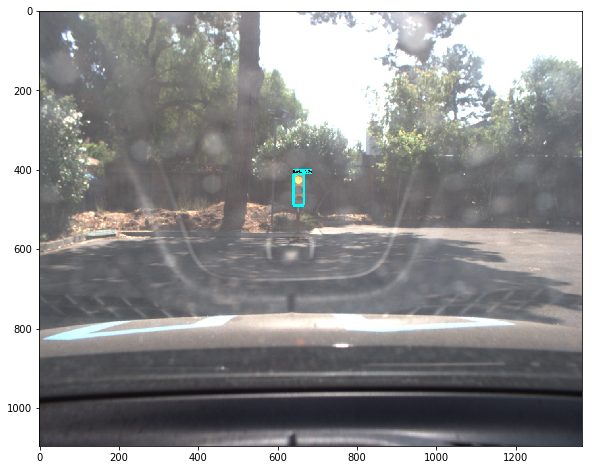

Red 0.999989


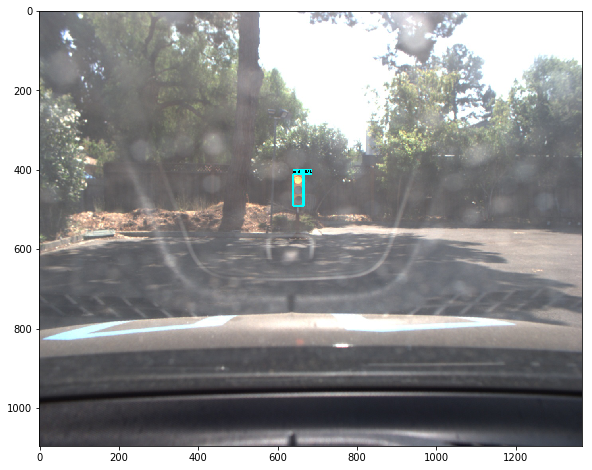

Red 0.99998


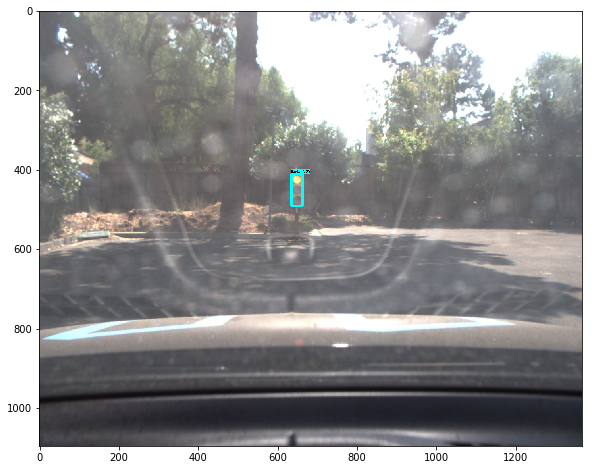

Red 0.999978


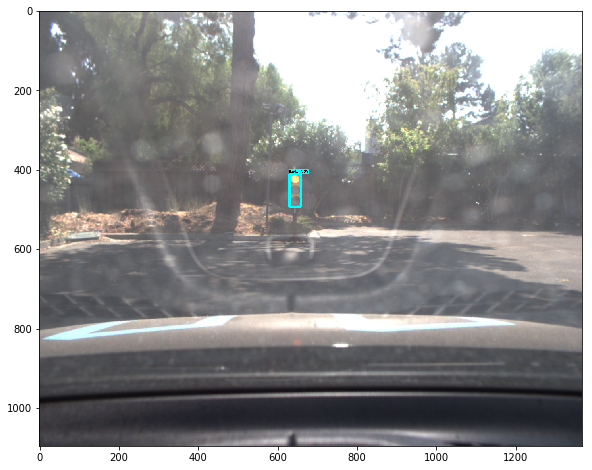

Red 0.999993


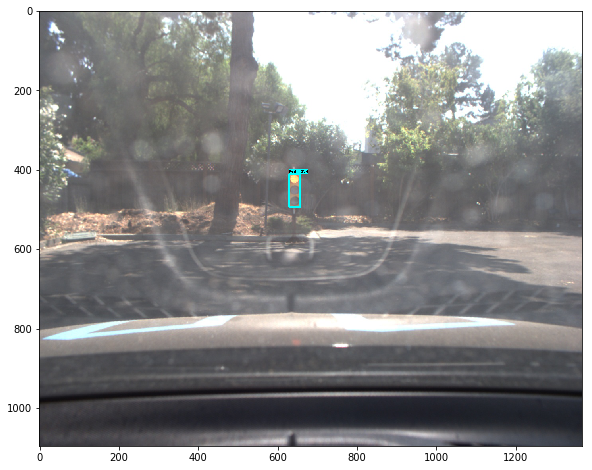

Red 0.999993


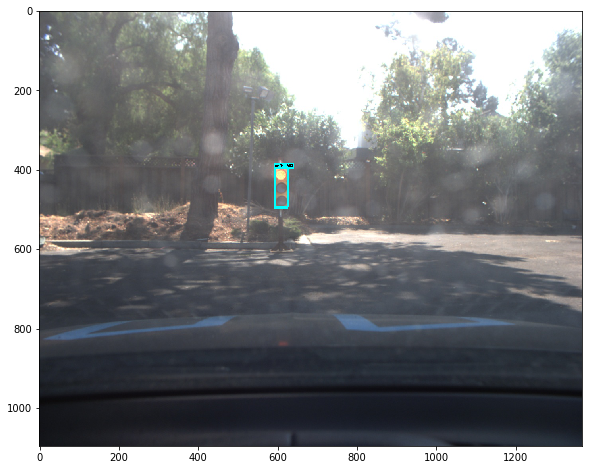

Red 0.99999


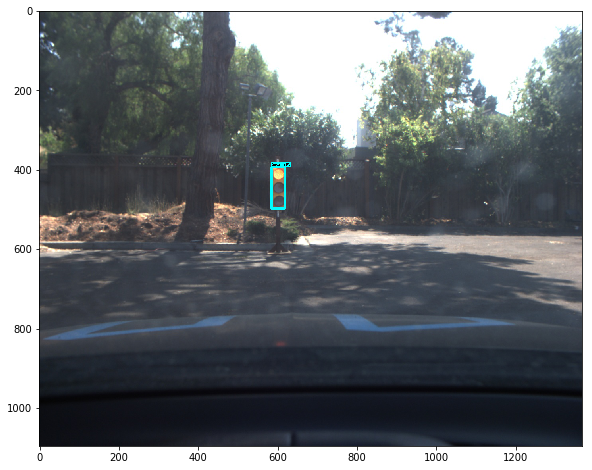

Red 0.999992


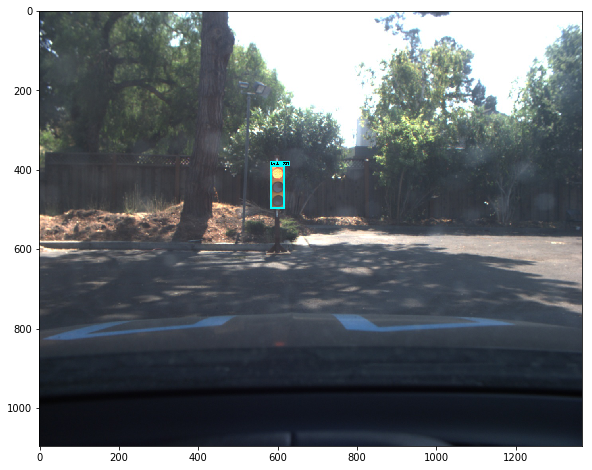

Red 0.999997


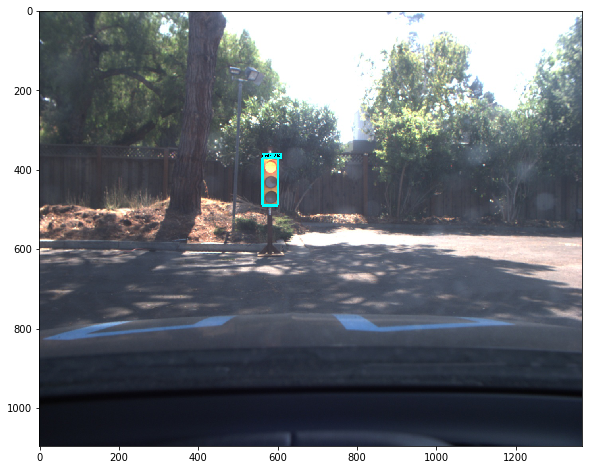

Red 0.999982


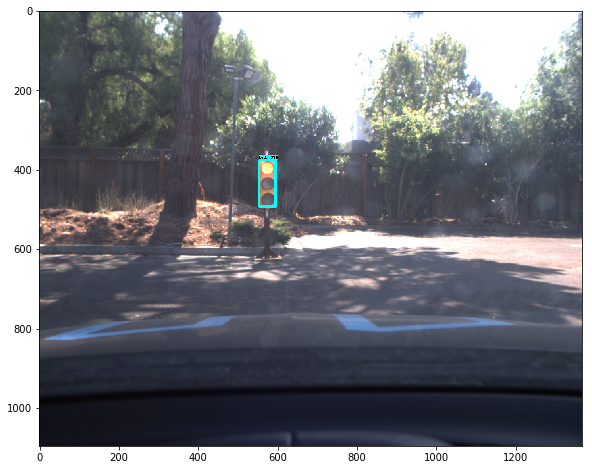

Red 0.999959


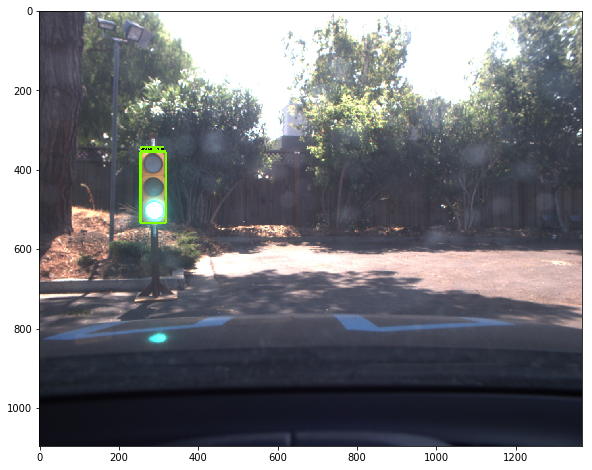

Green 0.999856


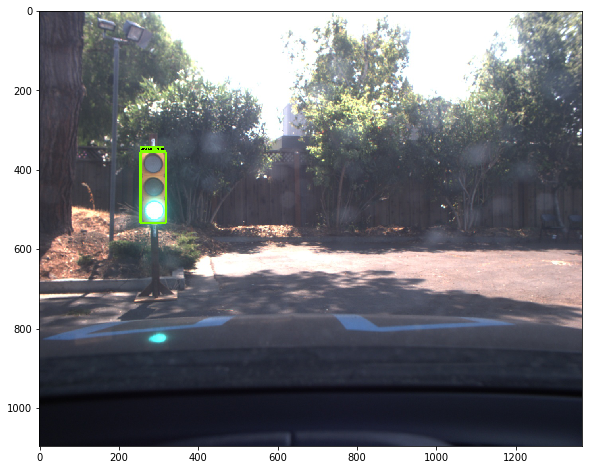

Green 0.999865


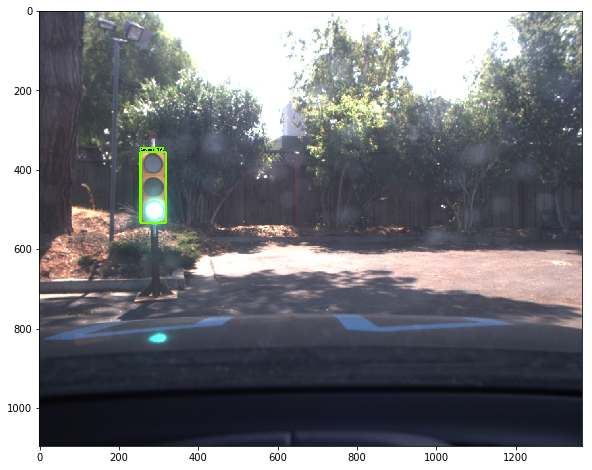

Green 0.999857


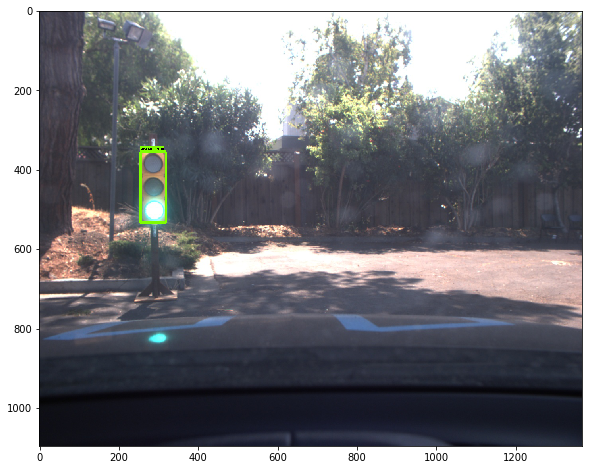

Green 0.999859


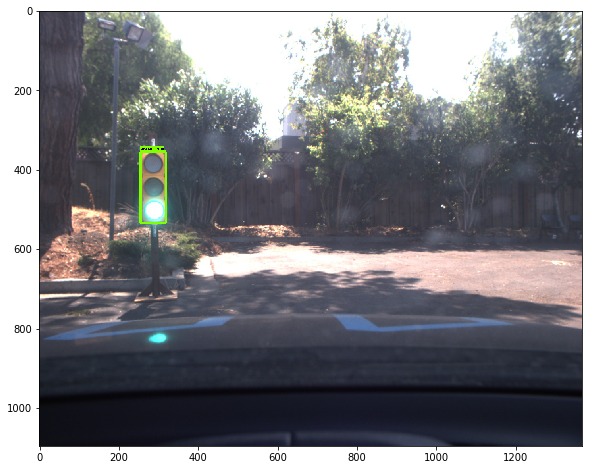

Green 0.99988


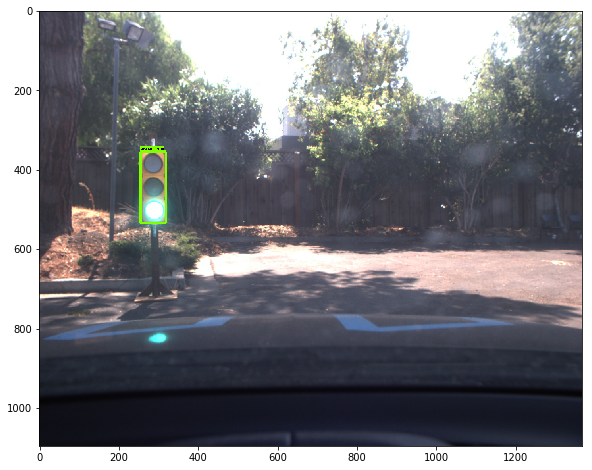

Green 0.999878


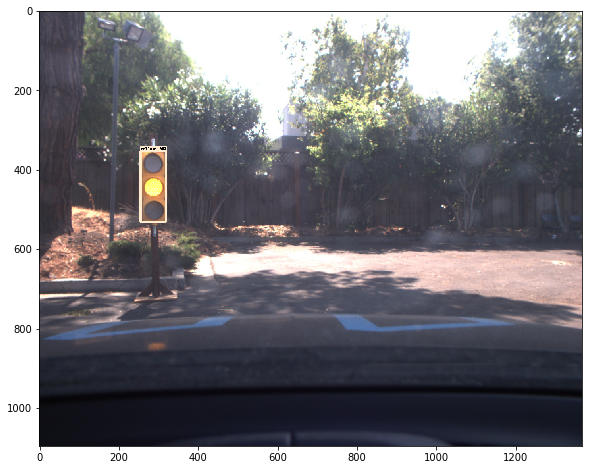

Yellow 0.989075


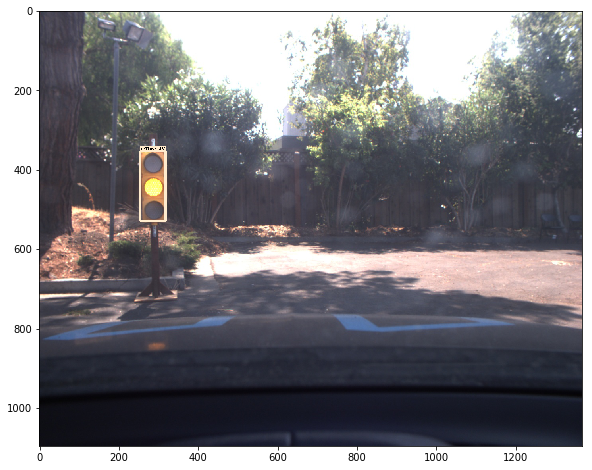

Yellow 0.984862


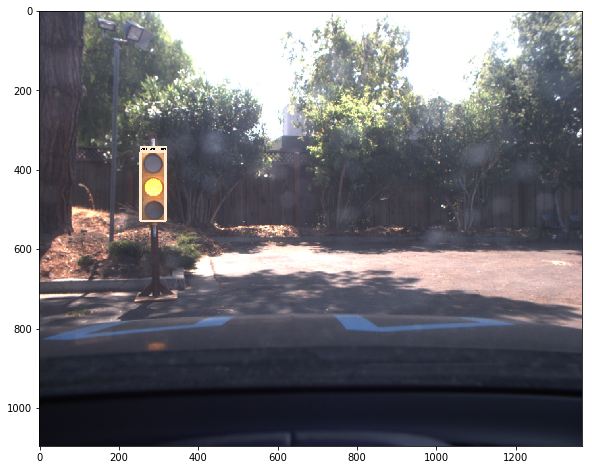

Yellow 0.985349


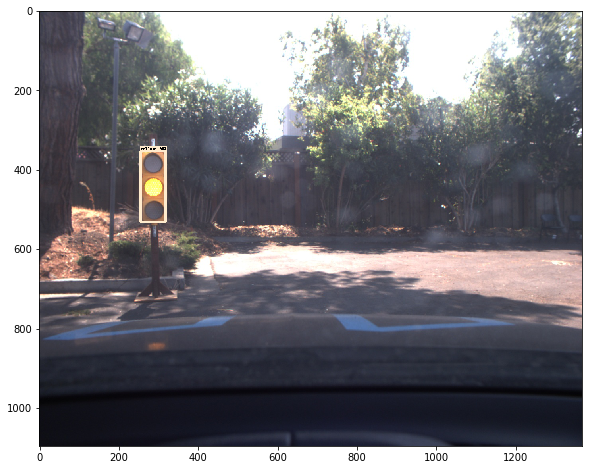

Yellow 0.988333


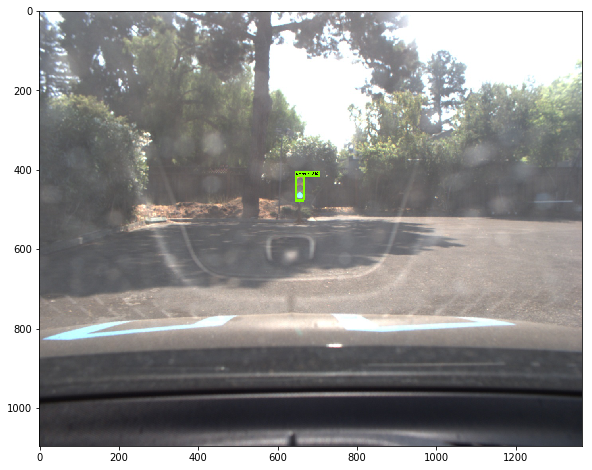

Green 0.999844


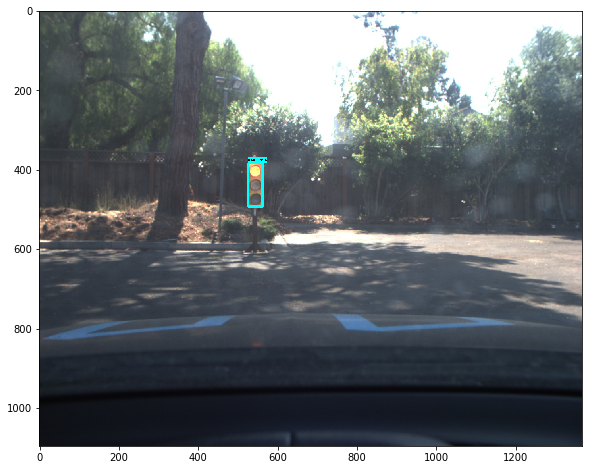

Red 0.999978


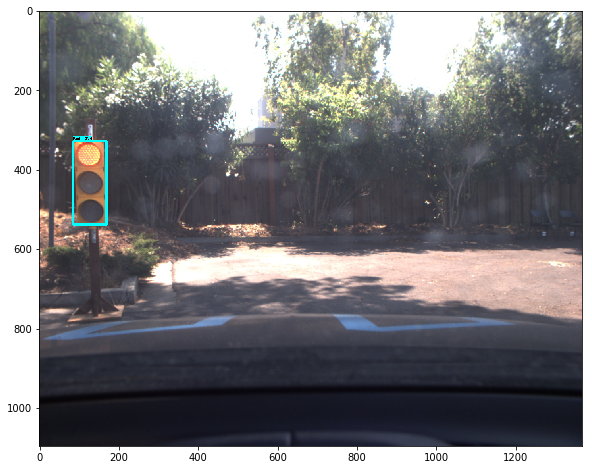

Red 0.99971


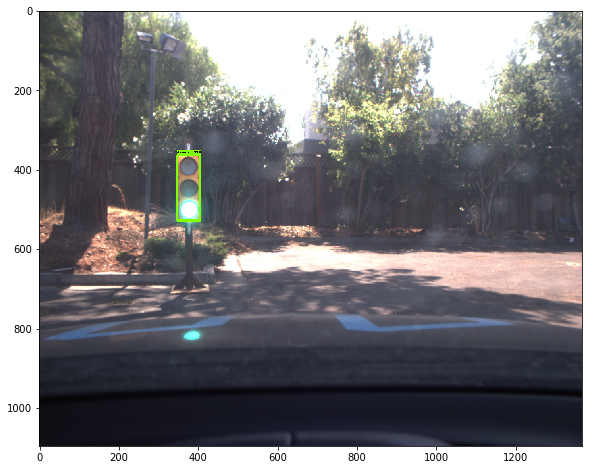

Green 0.999911


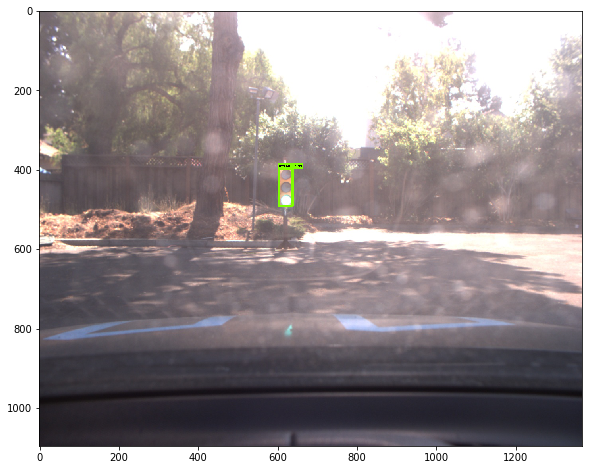

Green 0.999857


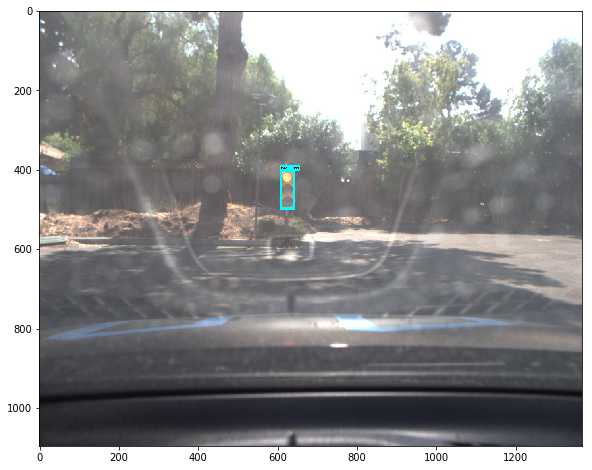

Red 0.999991


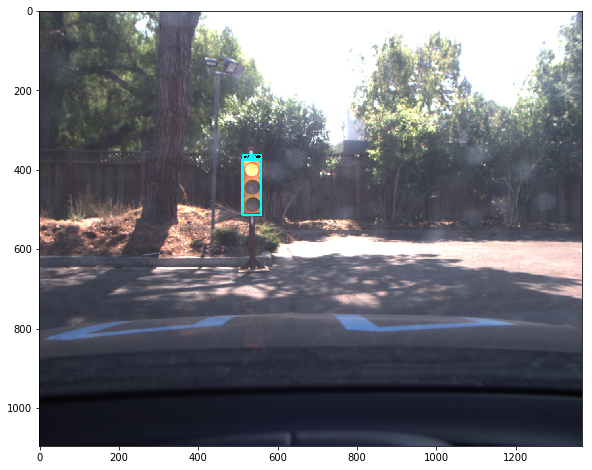

Red 0.999845


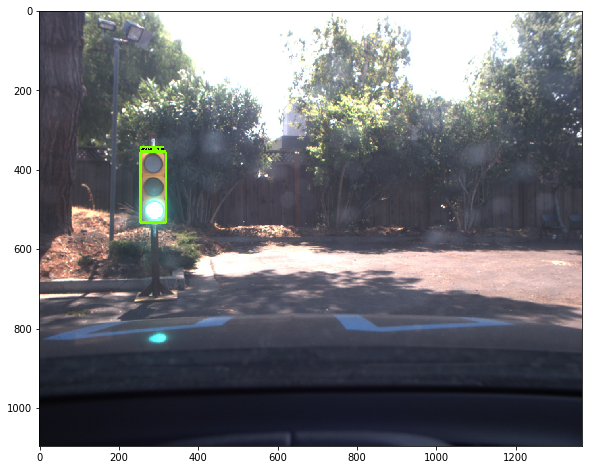

Green 0.999884


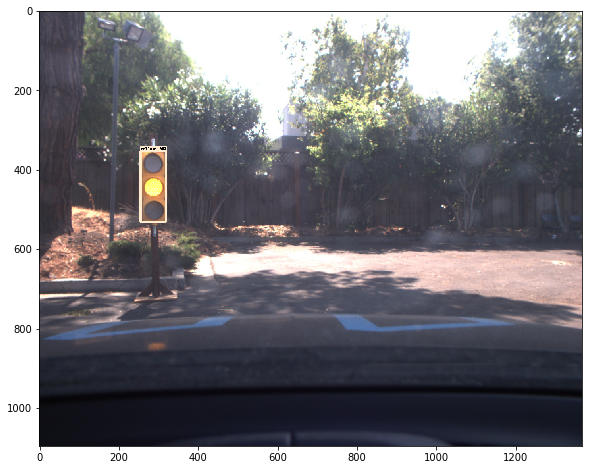

Yellow 0.989075


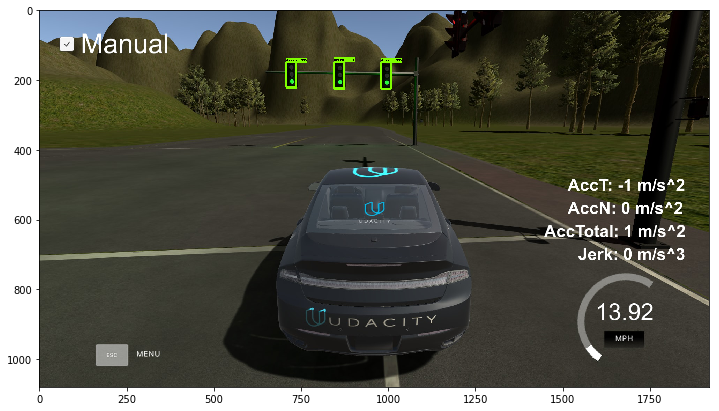

Green 0.999944
Green 0.999881
Green 0.999836


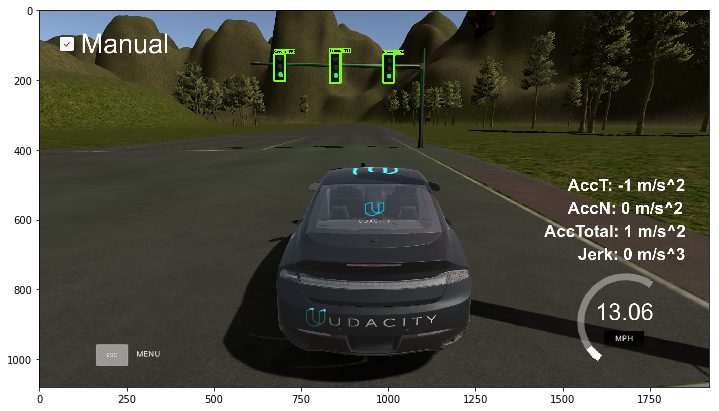

Green 0.999948
Green 0.999915
Green 0.999702


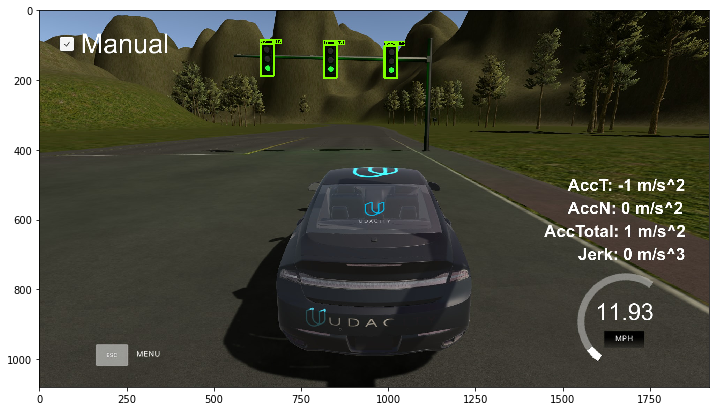

Green 0.99999
Green 0.999956
Green 0.999891


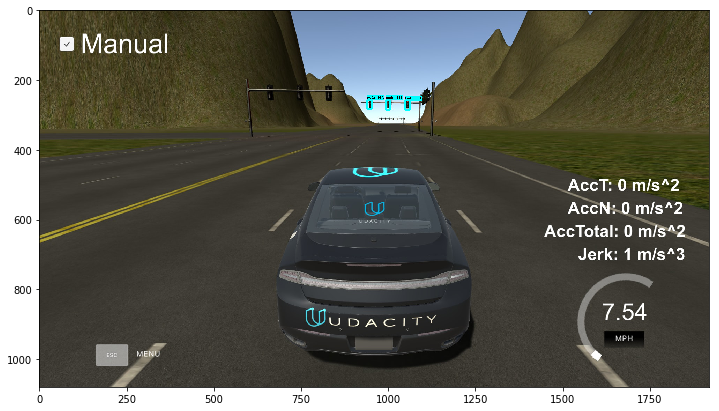

Red 0.996549
Red 0.993993
Red 0.968113


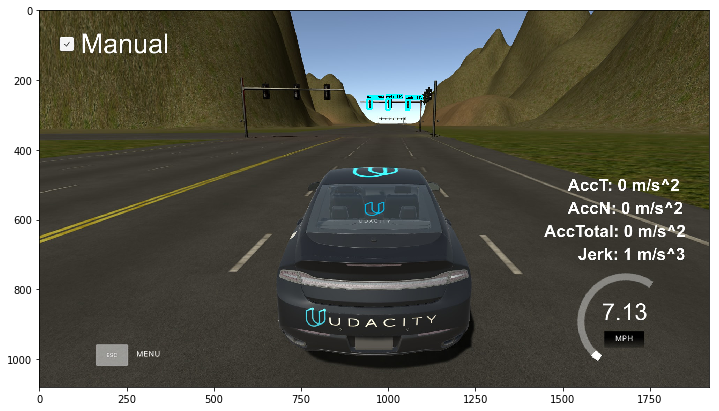

Red 0.99897
Red 0.997464
Red 0.965434


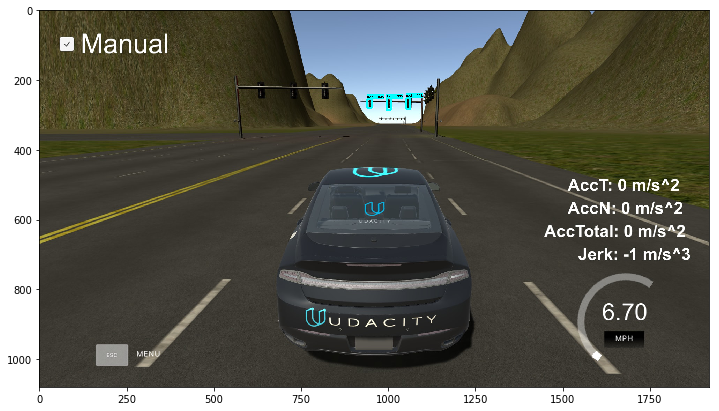

Red 0.997892
Red 0.992838
Red 0.927357


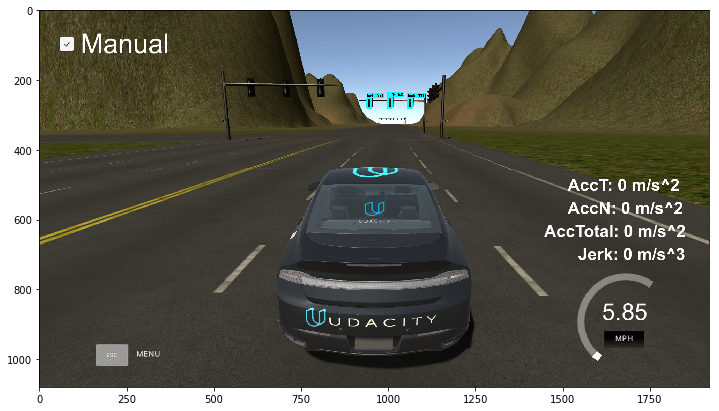

Red 0.999373
Red 0.994574
Red 0.960387


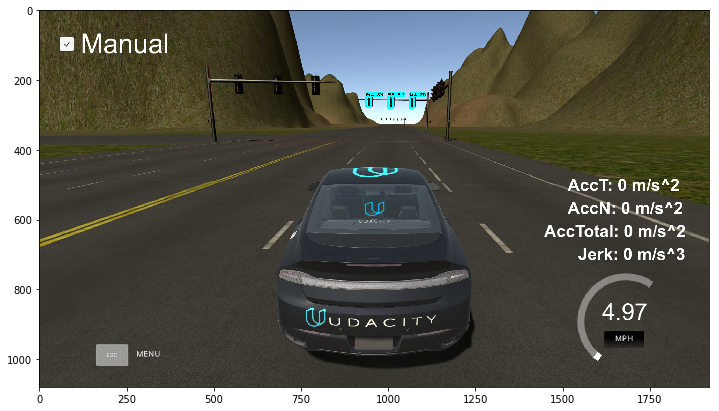

Red 0.999543
Red 0.998944
Red 0.974966


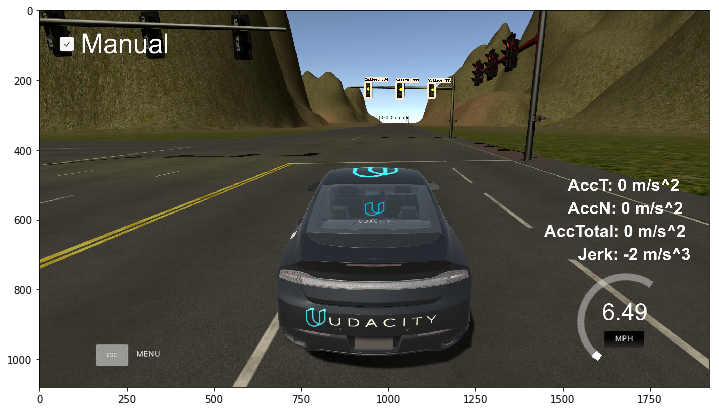

Yellow 0.999673
Yellow 0.999026
Yellow 0.996791


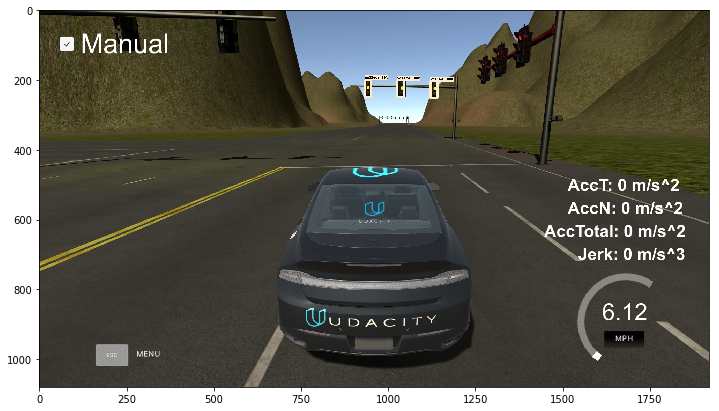

Yellow 0.999498
Yellow 0.999284
Yellow 0.988242


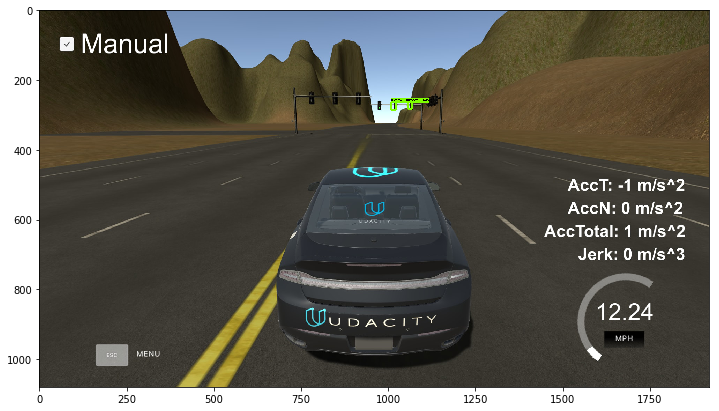

Green 0.993845
Green 0.630872


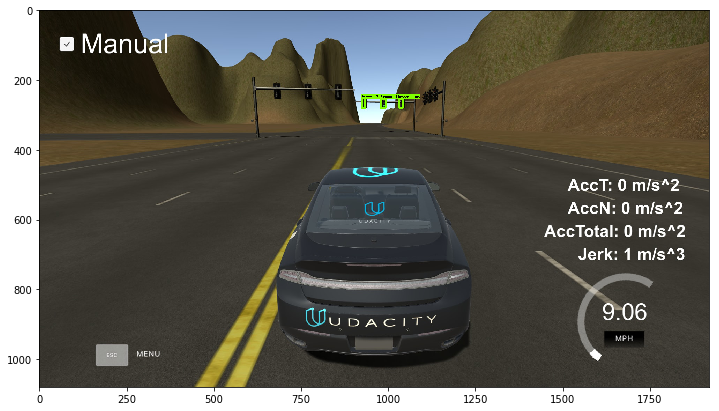

Green 0.99085
Green 0.985842
Green 0.984026


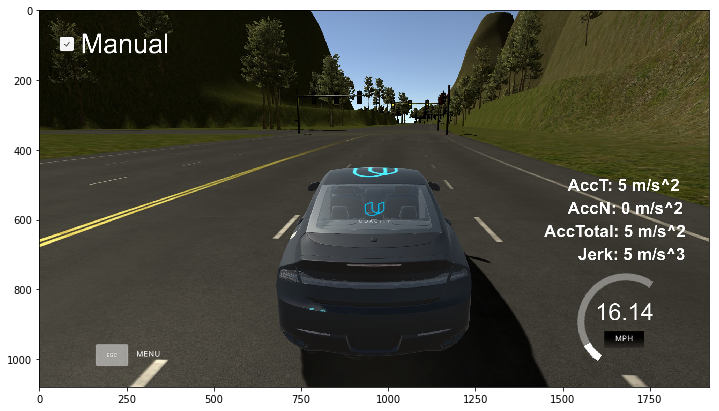

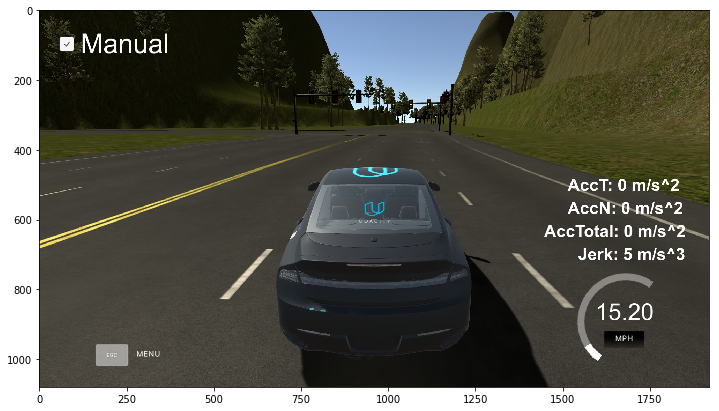

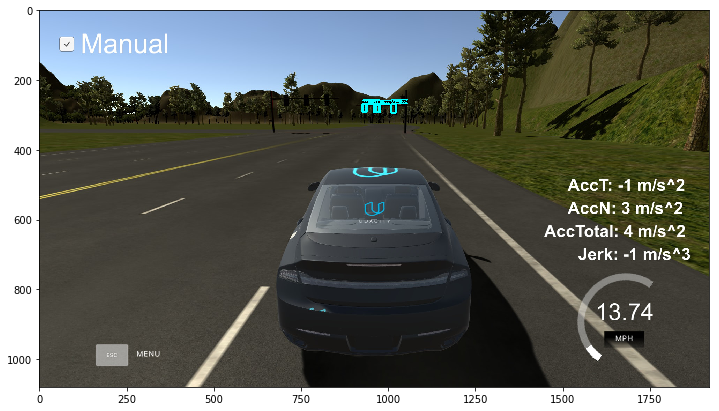

Red 0.999583
Red 0.993656
Red 0.965119
Red 0.938774
Red 0.660553


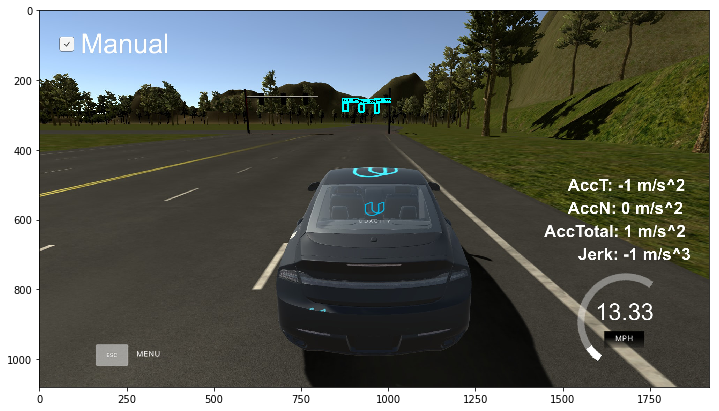

Red 0.999651
Red 0.99841
Red 0.827775


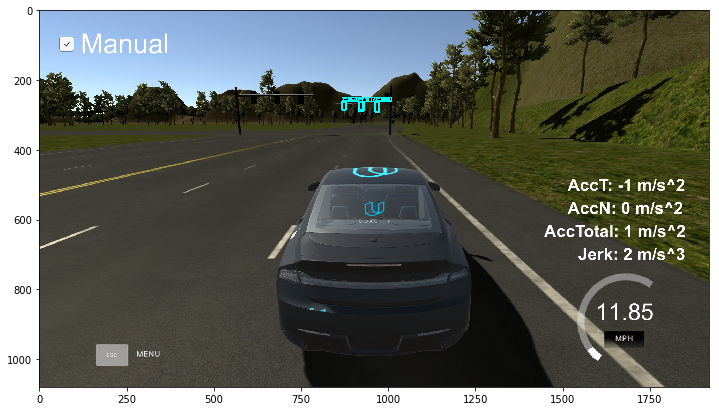

Red 0.999925
Red 0.993325
Red 0.97414


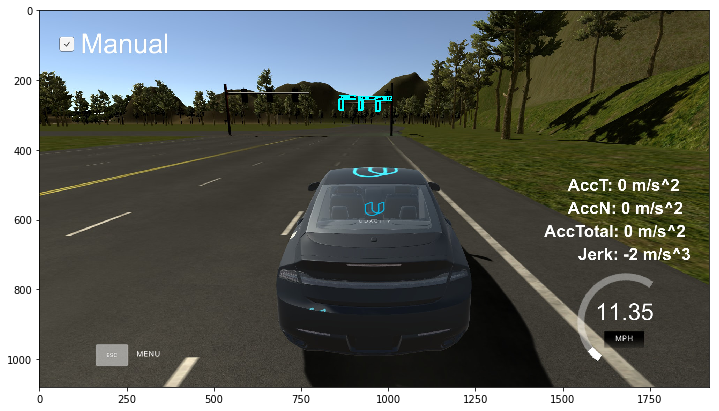

Red 0.999863
Red 0.998479
Red 0.88171


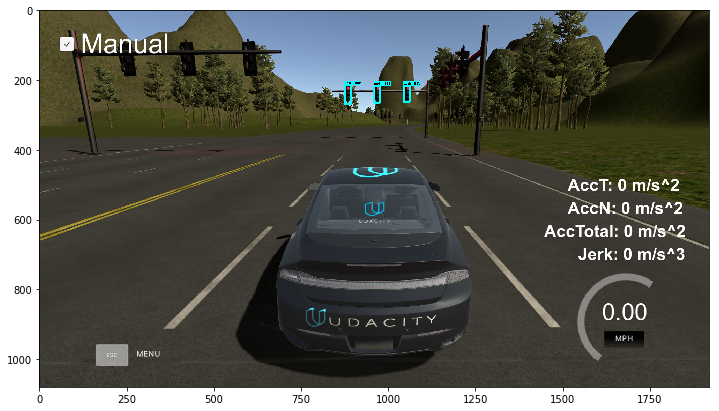

Red 0.999652
Red 0.99853
Red 0.997965


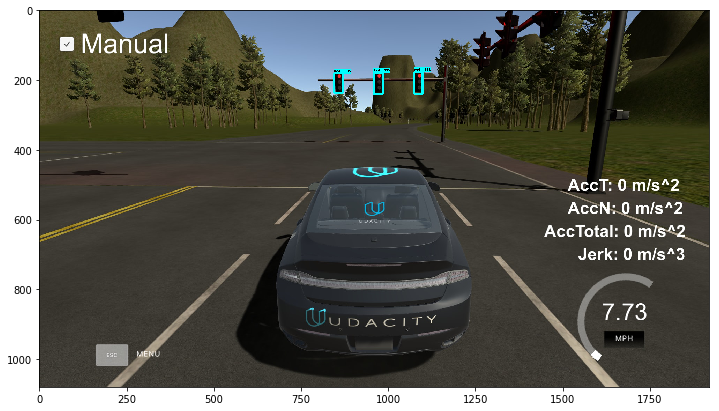

Red 0.999921
Red 0.999851
Red 0.999742


In [12]:
import time

with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in TEST_IMAGE_PATHS:
            image = Image.open(image_path)
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)

            time0 = time.time()

            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})

            time1 = time.time()

            boxes = np.squeeze(boxes)
            scores = np.squeeze(scores)
            classes = np.squeeze(classes).astype(np.int32)
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np, boxes, classes, scores,
                category_index,
                use_normalized_coordinates=True,
                line_thickness=6)
            
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.show()

            min_score_thresh = 0.5
            for i in range(boxes.shape[0]):
                if scores is None or scores[i] > min_score_thresh:

                    class_name = category_index[classes[i]]['name']
                    print('{}'.format(class_name), scores[i])            

In [13]:

PATH_TO_TEST_IMAGES_DIR = 'test_images'

print(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.png'))
print("Length of test images:", len(TEST_IMAGE_PATHS))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

test_images/*.jpg
Length of test images: 7


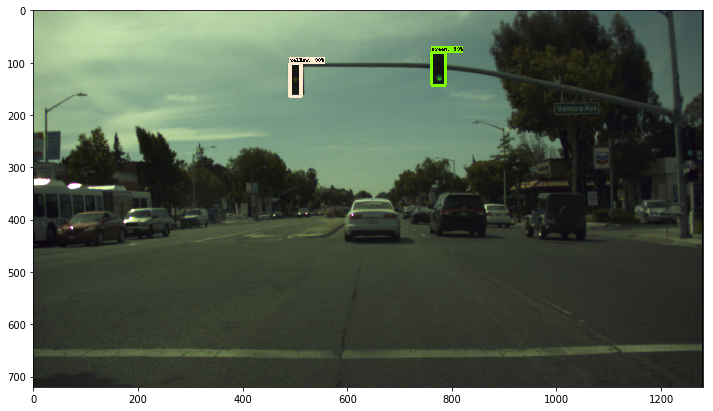

Green 0.999987
Yellow 0.984954


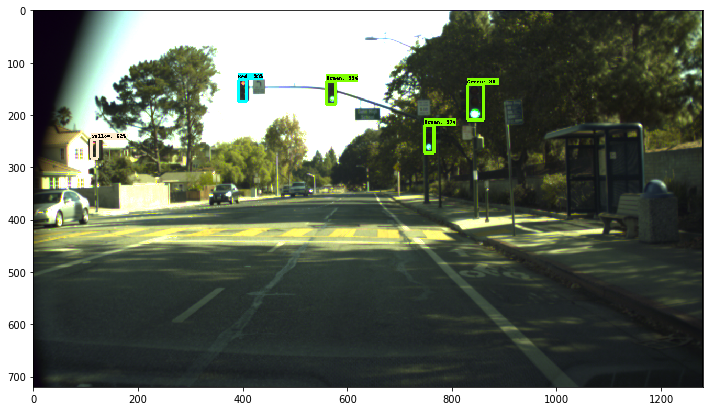

Green 0.9999
Red 0.99987
Green 0.999847
Green 0.974388
Yellow 0.623937


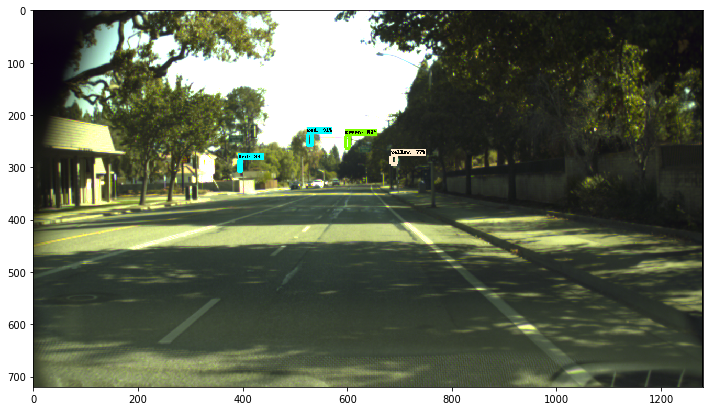

Red 0.91139
Red 0.84332
Yellow 0.778154
Green 0.53432


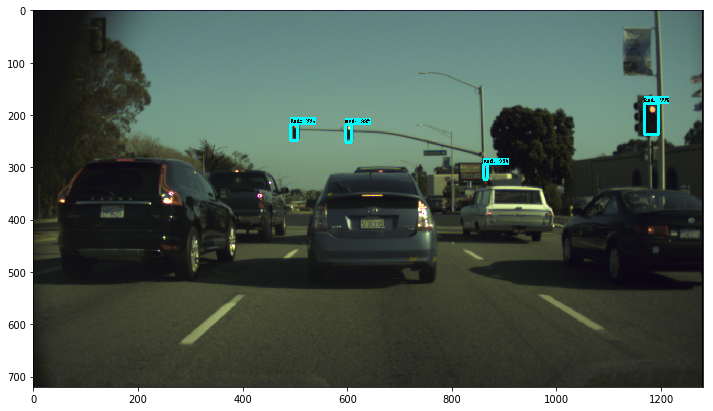

Red 0.999996
Red 0.999173
Red 0.999138
Red 0.992333


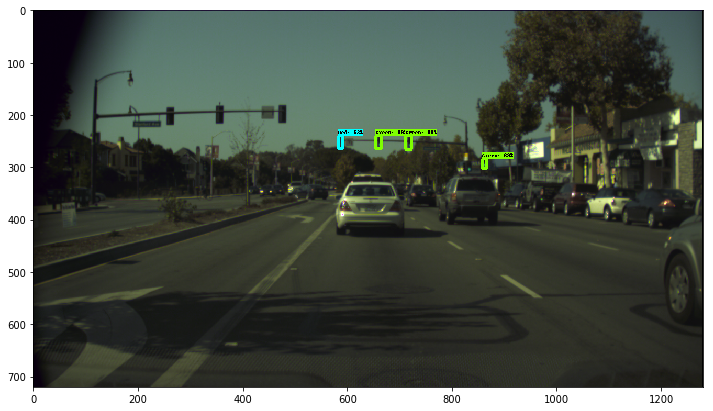

Green 0.996805
Green 0.995517
Green 0.69142
Red 0.631763


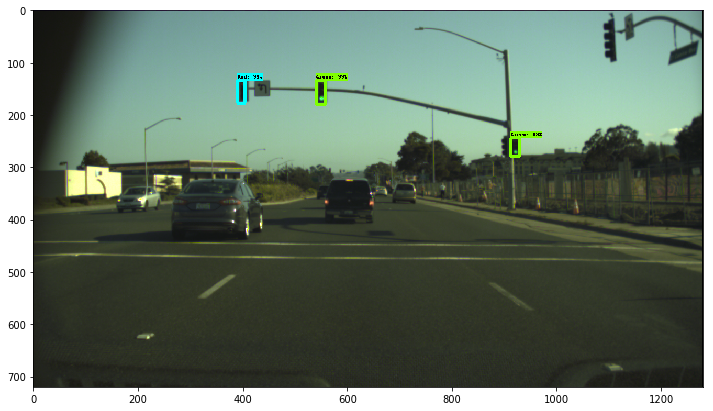

Green 0.999794
Red 0.999565
Green 0.998895


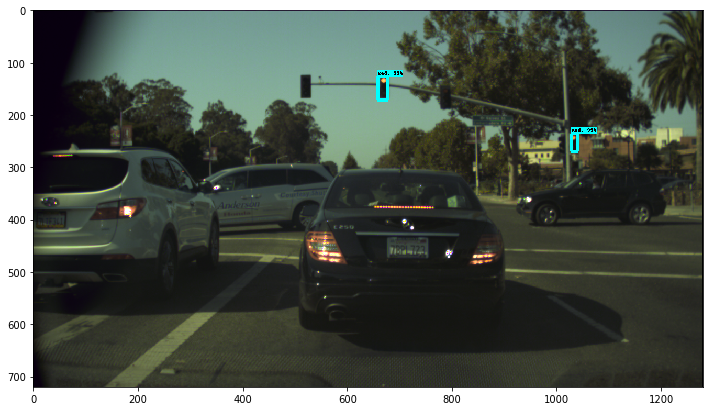

Red 0.999964
Red 0.999796


In [14]:
import time

with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in TEST_IMAGE_PATHS:
            image = Image.open(image_path)
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)

            time0 = time.time()

            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})

            time1 = time.time()

            boxes = np.squeeze(boxes)
            scores = np.squeeze(scores)
            classes = np.squeeze(classes).astype(np.int32)
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np, boxes, classes, scores,
                category_index,
                use_normalized_coordinates=True,
                line_thickness=6)
            
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.show()

            min_score_thresh = 0.5
            for i in range(boxes.shape[0]):
                if scores is None or scores[i] > min_score_thresh:

                    class_name = category_index[classes[i]]['name']
                    print('{}'.format(class_name), scores[i])            